## `Course evaluation information`

- Concisely note down your observations for each lab from now on.
- You can take notes inside the notebooks, or in separate PDFs.
- Either way, be ready to show the work you putted into each lab, including the experiments and the learning outcomes.
- During the exam, you will be asked to show your notes for some of the labs at random with a brief discussion on its content

# Lab. 1: Local search

## Introduction

#### <u>The goal is to study the application of local search algorithms on different benchmark functions.</u>

We will see the following methods:
- *Grid Search*
- *Random Search*
- *Powell*
- *Nelder Mead*

Moreover, we will study how their parameters change the behavior of these algorithms.

---

Getting started: the following code cell contains the core functions that we will use. Hence, **remember to run it every time the runtime is reconnected**.

It contains the three local search algorithms and a wrapper class called *OptFun* for the benchmark function.
As regards the *OptFun* class, the constructor takes as input a benchmark function (we will see later what functions are available). The relevant methods  are 4:
1.   *Minima*: returns a list of Optimum objects of the known global minima. If there aren't any minima, an empty list value will be returned instead. For each object, the position can be obtained by the parameter *position* and the function value from the *score* parameter.
2.   *Bounds*: returns where the function is defined
3.   *Heatmap*: show a heatmap of the function highlighting the points visited by the local search (use with 2d function)
4.   *plot*: show the trend of the points visited by the local search (use with 1d function)

Each instance of *OptFun* stores the history of the point at which the function has been evaluated. The history is never cleaned and can be obtained through *OptFun.history*. Hence, if you reuse the class instance remember to clean the history (*OptFun.history = list()*).

---

The benchmark functions available comes from the *benchmark_functions* library (imported as *bf*).
Example of the functions that can be used are the *Hypersphere*, the *Rastrign* the *DeJong5* and the Keane.
The complete list of functions available can be found at this [link](https://gitlab.com/luca.baronti/python_benchmark_functions) or you can print it with *dir(bf)*.

#### Base code to run every time the runtime is reconnected

In [224]:
%%capture

try:
  import benchmark_functions as bf
except:
  !pip3 install benchmark_functions
  import benchmark_functions as bf

from scipy.optimize import minimize, rosen
import numpy as np
from matplotlib import pyplot as plt
from copy import deepcopy
import inspect

plt.rcParams["figure.figsize"] = (8,5)

In [225]:
class OptFun():
    def __init__(self, wf):
        self.f = wf
        self.history = []

    def __call__(self, x0):
        self.history.append(deepcopy(x0))
        return self.f(x0)

    def minima(self):
        """
        Returns a list of Optimum objects of the known global minima. If there aren't any minima, an empty list value will be returned instead;

        Returns:
        - List of objects of class "benchmark_functions.functions_info_loader.Optimum"
        - For each object:
          - Access to 'position' parameter to get the axis values
          - Access to 'score' parameter to get the value of the function
        """
        return self.f.minima()

    def bounds(self):
        return self._convert_bounds(self.f.suggested_bounds())

    def heatmap(self, fn = None):
        plt.clf()
        resolution = 50
        fig = plt.figure()
        fig.canvas.manager.set_window_title('Benchmark Function: '+self.f._name)
        fig.suptitle(self.f._name)
        bounds_lower, bounds_upper = self.f.suggested_bounds()
        x = np.linspace(bounds_lower[0], bounds_upper[0], resolution)
        if self.f._n_dimensions>1:
            y = np.linspace(bounds_lower[1], bounds_upper[1], resolution)
            X, Y = np.meshgrid(x, y)
            Z = np.asarray([[self.f((X[i][j],Y[i][j])) for j in range(len(X[i]))] for i in range(len(X))])

        plt.contour(x,y,Z,15,linewidths=0.5,colors='k') # hight lines
        plt.contourf(x,y,Z,15,cmap='viridis', vmin=Z.min(), vmax=Z.max()) # heat map
        plt.xlabel('x')
        plt.ylabel('y')
        cbar = plt.colorbar()
        cbar.set_label('z')
        if len(self.history)>0:	# plot points
            xdata = [x[0] for x in self.history]
            ydata = [x[1] for x in self.history]
            plt.plot(xdata, ydata, "or-", markersize=2, linewidth=2)
        if fn is None:
            plt.show()
        else:
            plt.savefig(fn, dpi=400)

    def heatmap2(self, ax, fig):
        resolution = 50
        bounds_lower, bounds_upper = self.f.suggested_bounds()
        x = np.linspace(bounds_lower[0], bounds_upper[0], resolution)
        if self.f._n_dimensions>1:
            y = np.linspace(bounds_lower[1], bounds_upper[1], resolution)
            X, Y = np.meshgrid(x, y)
            Z = np.asarray([[self.f((X[i][j],Y[i][j])) for j in range(len(X[i]))] for i in range(len(X))])

        ax.contour(x,y,Z,15,linewidths=0.5,colors='k') # hight lines
        cs = ax.contourf(x,y,Z,15,cmap='viridis', vmin=Z.min(), vmax=Z.max()) # heat map
        ax.set_xlabel('x')
        ax.set_ylabel('y')
        cbar = fig.colorbar(cs, ax=ax, shrink=0.9)
        cbar.set_label('z')
        if len(self.history)>0:	# plot points
            xdata = [x[0] for x in self.history]
            ydata = [x[1] for x in self.history]
            ax.plot(xdata, ydata, "or-", markersize=2, linewidth=2)

    def plot(self):
        plt.clf()
        values = [self.f(v) for v in self.history]
        min = func.minima()[0].score
        plt.plot(values, label="trend of found points")
        plt.axhline(min, color="r", label="optimum")
        plt.xlabel('Iterations')
        plt.ylabel('f(x)')
        plt.legend()
        plt.show()

    def plot2(self, ax):
        values = [self.f(v) for v in self.history]
        min = func.minima()[0].score
        ax.plot(values, label="trend of found points")
        ax.axhline(min, color="r", label="optimum")
        

    def _convert_bounds(self, bounds):
        new_bounds= []
        for i in range(len(bounds[0])):
            new_bounds.append((bounds[0][i], bounds[1][i]))
        return new_bounds

    def current_calls(self):
        return len(self.history)

def grid_search(f: OptFun, step_size=None, number_of_steps=None, minimization=True):
    """
    Optimizes a function by using the grid_search algorithm.

    - f: function to optimize, an instance of OptFun
    - step_size: the step size
    - number_of_steps: the total number of steps
    - minimization: boolean, True if looking for minimum, False if looking for maximum; defauls True

    Returns:
    - best value found
    """

    if (step_size != None):
      range_step_size = step_size
    elif (number_of_steps != None):
        range_step_size = int(np.floor(np.sqrt(number_of_steps)))
    else:
        print("Please provide at least the step_size or the number_of_steps")
        return

    bounds = f.bounds()
    best = float('inf') if minimization else float('sup')

    for x in np.arange(bounds[0][0], bounds[0][1], range_step_size):
      for y in np.arange(bounds[1][0], bounds[1][1], range_step_size):
        current = f([x, y])
        if minimization:
          if current < best:
            best = current
        else:
          if current > best:
            best = current

    return best

def random_search(f: OptFun, n_samples_drawn, minimization=True):
    """
    Optimizes a function by using the random_search algorithm.

    - f: function to optimize, an instance of OptFun
    - number_of_steps: the total number of steps
    - minimization: boolean, True if looking for minimum, False if looking for maximum; defauls True

    Returns:
    - best value found
    """

    bounds = f.bounds()
    best = float('inf') if minimization else float('sup')
    for i in range(n_samples_drawn):
      x = np.random.uniform(bounds[0][0], bounds[0][1])
      y = np.random.uniform(bounds[1][0], bounds[1][1])
      current = f([x, y])
      if minimization:
        if current < best:
          best = current
      else:
        if current > best:
          best = current

    return best

def powell(f: OptFun, x0, maxiter: int):
    """
    Optimizes a function by using the Powell algorithm.

    - f: function to optimize, an instance of OptFun
    - x0: starting point for the search process
    - maxiter: maximum number of iterations
    """
    bounds = f.bounds()
    results = minimize(fun=f, x0=list(x0), method="powell", bounds=bounds,
                       options={"ftol":1e-4,
                                "maxfev": None,
                                "maxiter": maxiter,
                                "return_all":True})
    return results

def nelder_mead(f: OptFun, x0, maxiter: int):
    """
    Optimizes a function by using the Nelder-Mead algorithm.

    - f: function to optimize, an instance of OptFun
    - x0: starting point for the search process
    - maxiter: maximum number of iterations
    """
    bounds = f.bounds()
    return minimize(
        f,
        x0,
        method='Nelder-Mead',
        tol=None,
        bounds=bounds,
        options={
            "maxfev": None,
            "maxiter": maxiter,
            'disp': False,
            'return_all': True,
            'initial_simplex': None,
            'xatol': 0.000,
            'fatol': 0.000,
            'adaptive': False
        }
    )

In [226]:

def printClassInitArgs(class_obj):
    signature = inspect.signature(class_obj.__init__).parameters
    print("-------------------------------")
    for name, parameter in signature.items():
        print("Name: ", name, "\nDefault value:", parameter.default)
        #print("Annotation:", parameter.annotation, "\nKind:", parameter.kind)
        print("-------------------------------")

# Exercises

#### Solve the following exercises, and answer these questions at the end:

- How the benchmark functions influence the optimization algorithms? There is an algorithm which is always better than the other?
- The choiche of the parameters is influenced by the function to optimize? And how the algorithm are influenced by the parameters?

In [227]:
# BE AWARE: check the arguments each benchmark function takes and ignore the "opposite" argument
# if you're not sure, you can check the arguments by using the printClassInitArgs function
printClassInitArgs(bf.DeJong5())

printClassInitArgs(bf.Hypersphere())


-------------------------------
Name:  opposite 
Default value: False
-------------------------------
-------------------------------
Name:  n_dimensions 
Default value: 2
-------------------------------
Name:  opposite 
Default value: False
-------------------------------


## Exercise 1/4: GRID SEARCH
In this first exercise we will use grid search as a search algorithm

### Questions
- How does the step size influence the quality of the best point obtained?
- How does the step size influence the search cost?

Bounds: [(-5.0, 5.0), (-5.0, 5.0)]
Best value: 0.0


<Figure size 800x500 with 0 Axes>

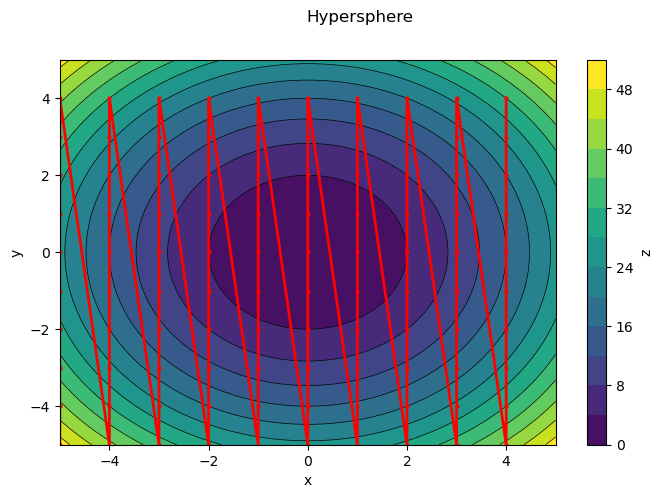

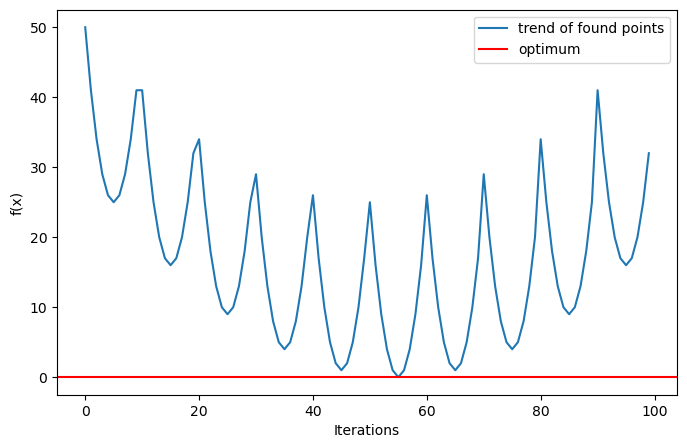

In [228]:
bench_func = bf.Hypersphere(n_dimensions=2) 
func = OptFun(bench_func)
print("Bounds:", func.bounds())

step_size = 1  

best = grid_search(func, step_size=step_size)

print("Best value:", best)

func.heatmap()
func.plot()

### Solutions
 - With this algorithm we expect that decreasing the step size (=increasing the number of total steps) will generally increase (can remain the same or even decrease if the previous point changes in positions) the quality of the search, since we consider more points and consequently perform a finer search on the space.

 - Suppose that the computatinal cost of evaluating the function in a point is $E$ and that the total number of points of the grid is $N_p$ than the computational cost of the algorithm is $ C = E * N_p$. If we consider $E$ constant time ($O(1)$) then $C = O(N_p)$.   
    If we consider the step_size $s$, the number of dimension of the search space $D_s$ and the lower and ubber bound for each dimension as $l_i$, $u_i$ respectively then

   $$
       C = \prod_{i=1}^{D_s} E * \left \lfloor{\frac{u_i - l_i}{s}}\right \rfloor = \prod_{i=1}^{D_s} E * N_i
   $$
    where $N_i$ is the number of points that we consider for the dimension $i$. If $\forall i,j \in D_s. N_i = N_j := N$ then $C = (E*N)^{D_s}$ which is exponential in respect of the number of dimension $D_s$.   
    The grid search algorithm suffer from the exponential explosion, which consist of an exponential growth, because the naive version and in case of constrain the grid search algorithm perform subset generation, permutation and combinatorial checks.
    However we must consider that evaluation can be parallelized.

    The advantages of this algorithm is that it didn't need any strong requirement on the problem. 
   
   In the following we have to minimize a continuous function on a 2 dimensional space, the grid search will perform a discretization of the search space considering only the points on the grid constructed by the algorithm according to the step size.

### different step_size values

best_results:  [0.0, 0.0, 2.0]


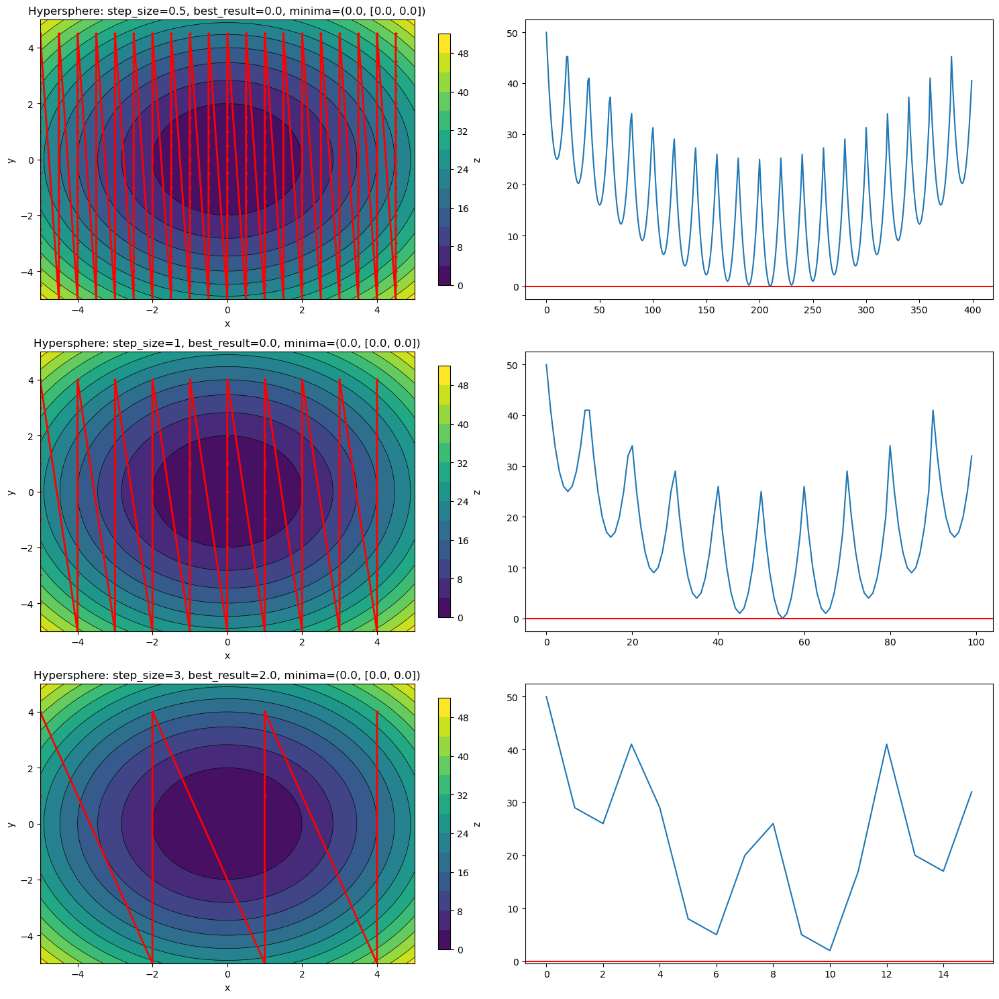

In [229]:
step_size_l  = [0.5, 1, 3]
best_results = []

fig, axs = plt.subplots(len(step_size_l), 2, figsize=(15, 15))

for i, step_size in enumerate(step_size_l):
    bench_func = bf.Hypersphere(n_dimensions=2)
    func = OptFun(bench_func)
    best = grid_search(func, step_size=step_size)
    best_results.append(best)

    axs[i, 0].set_title(func.f._name + ": step_size=" + str(step_size) + ", best_result=" + str(best) + ", minima=" + str(func.minima()[0]))
    func.heatmap2(axs[i][0], fig)
    func.plot2(axs[i][1])

fig.tight_layout()
print("best_results: ", best_results)

We can notice that with step_size=3 there isn't any point on the grid that hit the point (0,0) so it didn't reach the optimal minimum.

### Differenct benchmark function

In [230]:
dir(bf)

['ABC',
 'Ackley',
 'BenchmarkFunction',
 'DeJong3',
 'DeJong5',
 'Easom',
 'EggHolder',
 'GoldsteinAndPrice',
 'Griewank',
 'Himmelblau',
 'Hyperellipsoid',
 'Hypersphere',
 'Keane',
 'MartinGaddy',
 'McCormick',
 'Michalewicz',
 'PichenyGoldsteinAndPrice',
 'PitsAndHoles',
 'Rana',
 'Rastrigin',
 'Rosenbrock',
 'Schaffer2',
 'Schwefel',
 'StyblinskiTang',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__path__',
 '__spec__',
 'abstractmethod',
 'benchmark_functions',
 'fil',
 'functions_info_loader',
 'logging',
 'math',
 'multivariate_normal',
 'np']

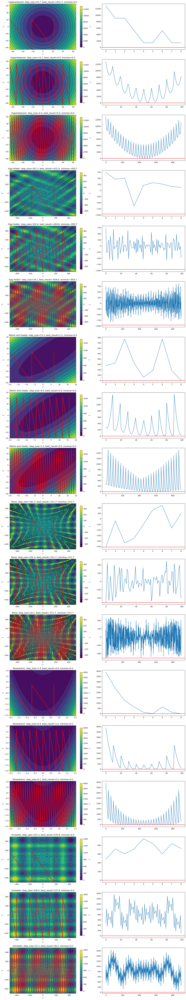

In [231]:
func_list = [('Hyperellipsoid', {'n_dimensions': 2}), 
             ('EggHolder', {}),
             ('MartinGaddy', {}),
             ('Rana', {'n_dimensions': 2}),
             ('Rosenbrock', {'n_dimensions': 2}),
             ('Schwefel', {'n_dimensions': 2})
            ]
n_points_sd = [3, 10, 30] # 10 or 30 points in for smallest dimension length

grid_search_results = []

fig, axs = plt.subplots(len(func_list)*len(n_points_sd), 2, figsize=(15, 80))

for i, (func_name, params) in enumerate(func_list):
    i = i*len(n_points_sd)
    for j, n in enumerate(n_points_sd):
        bench_func = bench_func = getattr(bf, func_name)(**params)
        func = OptFun(bench_func)
        step_size = min([ub-lb for (lb, ub) in func.bounds()])/n                         

        best = grid_search(func, step_size=step_size)
        grid_search_results.append({'technique': "grid_search",
                                    'func_name': func_name,
                                    'n_points' : n*n,
                                    'best'     : best,
                                    'minima'   : func.minima()[0].score
                                   })

        axs[i+j, 0].set_title(func.f._name + ": step_size=" + "{:.1f}".format(step_size) + 
                        ", best_result=" + "{:.1f}".format(best) + 
                        ", minima=" + "{:.1f}".format(func.minima()[0].score))
        func.heatmap2(axs[i+j][0], fig)
        func.plot2(axs[i+j][1])

fig.tight_layout()


In [232]:
import pandas as pd
grid_search_df = pd.DataFrame(grid_search_results)
grid_search_df['err_gs'] = abs(grid_search_df['minima'] - grid_search_df['best'])
print(grid_search_df.to_markdown(index=False))

| technique   | func_name      |   n_points |           best |         minima |         err_gs |
|:------------|:---------------|-----------:|---------------:|---------------:|---------------:|
| grid_search | Hyperellipsoid |          9 | 1431.66        |    0           | 1431.66        |
| grid_search | Hyperellipsoid |        100 |    0           |    0           |    0           |
| grid_search | Hyperellipsoid |        900 |    2.42338e-27 |    0           |    2.42338e-27 |
| grid_search | EggHolder      |          9 | -631.932       | -959.713       |  327.781       |
| grid_search | EggHolder      |        100 | -604.61        | -959.713       |  355.103       |
| grid_search | EggHolder      |        900 | -828.594       | -959.713       |  131.119       |
| grid_search | MartinGaddy    |          9 |    1.23457     |    0           |    1.23457     |
| grid_search | MartinGaddy    |        100 |    0.444444    |    0           |    0.444444    |
| grid_search | MartinGaddy   

In this experiments we can notice that the greater number of evaluated points leads to a better solution.

We can also notice that for this algorithm is not relevant the shape of the objective function.

## Exercise 2/4: RANDOM SEARCH

In this exercise we will use Random Search to search for the optimum

### Questions
- How does the number of samples drawn affect the search?
- How does this method compare to Grid Search? What are the advantages and disadvantages?

Bounds: [(-5.0, 5.0), (-5.0, 5.0)]
Best value: 0.4356666192572023


<Figure size 800x500 with 0 Axes>

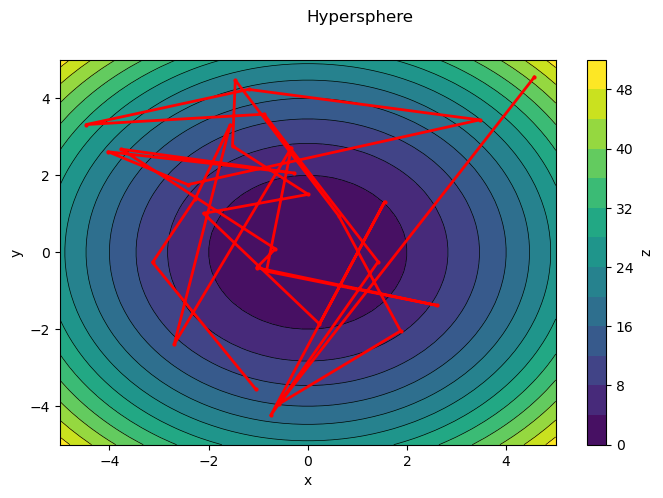

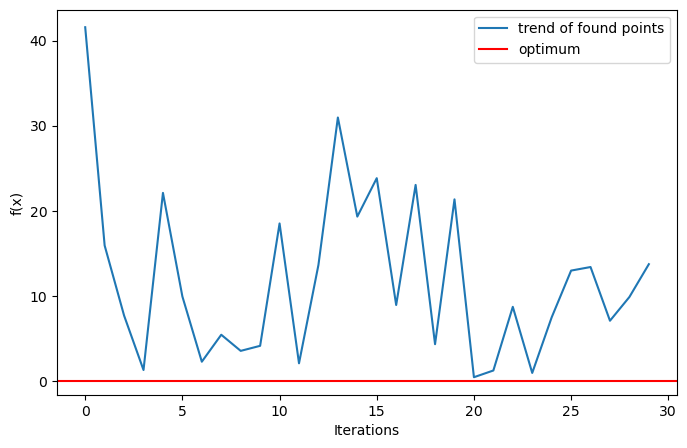

In [233]:
bench_func = bf.Hypersphere(n_dimensions=2) #TODO: try differenct benchmark function
func = OptFun(bench_func)
print("Bounds:", func.bounds())

n_samples_drawn = 30  # TODO: try different values (e.g.: [3, 30, 50])

best = random_search(func, n_samples_drawn)
print("Best value:", best)

func.heatmap()
func.plot()

### Solution
- The number of drawn positively affect the search given that more points are considered, moreover a bigger drawn increase the possibility of better exploring the search space

### Different drawn sizes

best_results:  [10.268059142146166, 2.6797459551967955, 0.8707349746496903]


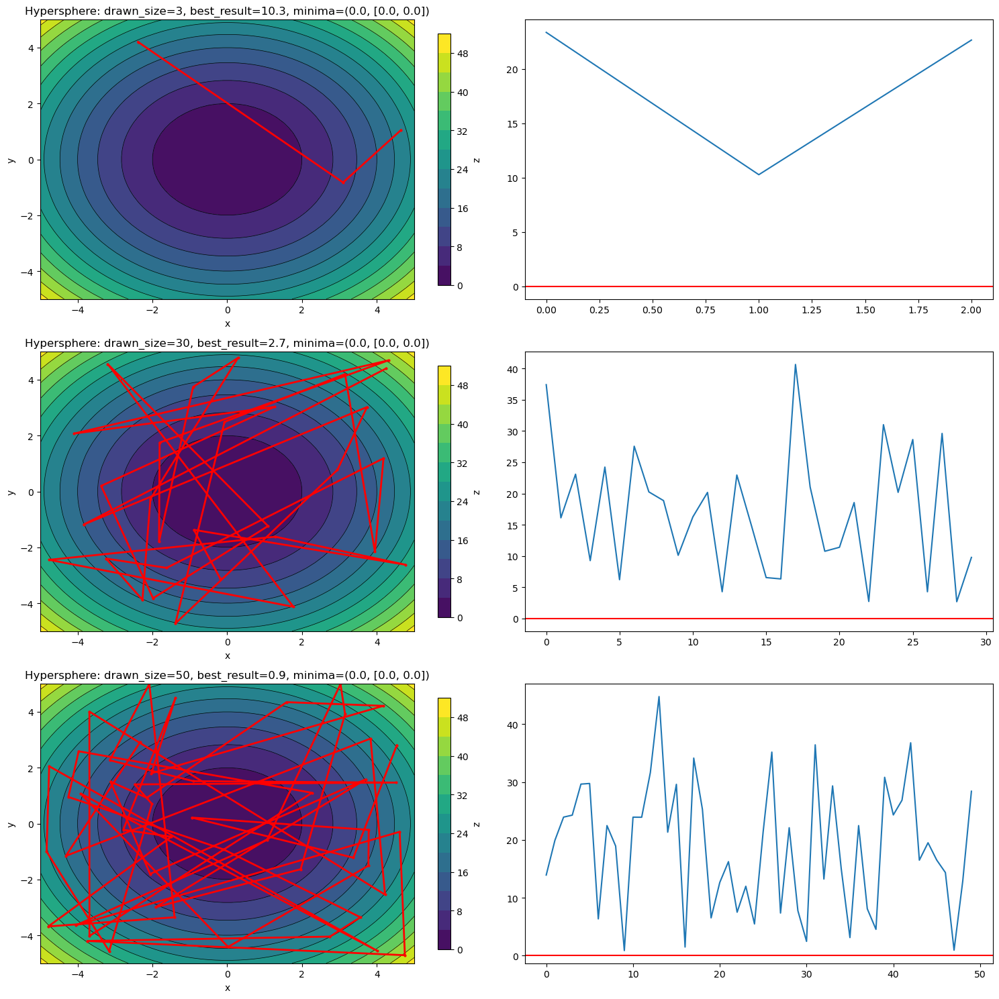

In [234]:
drawn_sizes  = [3, 30, 50]
best_results = []

fig, axs = plt.subplots(len(drawn_sizes), 2, figsize=(15, 15))

for i, drawn_size in enumerate(drawn_sizes):
    bench_func = bf.Hypersphere(n_dimensions=2)
    func = OptFun(bench_func)
    best = random_search(func, drawn_size)
    best_results.append(best)

    axs[i, 0].set_title(func.f._name + ": drawn_size=" + str(drawn_size) + ", best_result=" + "{:.1f}".format(best) + ", minima=" + str(func.minima()[0]))
    func.heatmap2(axs[i][0], fig)
    func.plot2(axs[i][1])

fig.tight_layout()
print("best_results: ", best_results)

### Differenct benchmark function

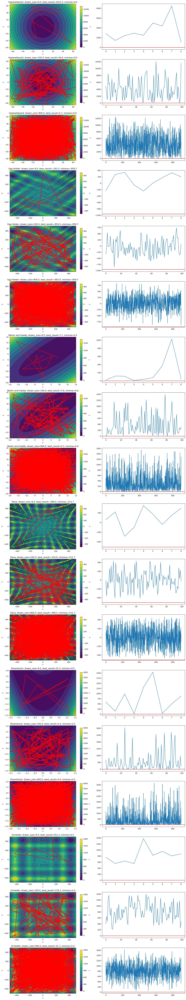

In [235]:
func_list = [('Hyperellipsoid', {'n_dimensions': 2}), 
             ('EggHolder', {}),
             ('MartinGaddy', {}),
             ('Rana', {'n_dimensions': 2}),
             ('Rosenbrock', {'n_dimensions': 2}),
             ('Schwefel', {'n_dimensions': 2})
            ]
n_points_sd = [3, 10, 30] # use the same parameter of grid_search to calculate the same number of points

fig, axs = plt.subplots(len(func_list)*len(n_points_sd), 2, figsize=(15, 80))

random_search_results = []

for i, (func_name, params) in enumerate(func_list):
    i = i*len(n_points_sd)
    for j, n in enumerate(n_points_sd):
        bench_func = bench_func = getattr(bf, func_name)(**params)
        func = OptFun(bench_func)
        drawn_size = n*n
        
        best = random_search(func, drawn_size)

        random_search_results.append({  'technique': "random_search",
                                        'func_name': func_name,
                                        'n_points' : drawn_size,
                                        'best'     : best,
                                        'minima'   : func.minima()[0].score
                                    })
        
        axs[i+j, 0].set_title(func.f._name + ": drawn_size=" + "{:.1f}".format(drawn_size) + 
                        ", best_result=" + "{:.1f}".format(best) + 
                        ", minima=" + "{:.1f}".format(func.minima()[0].score))
        func.heatmap2(axs[i+j][0], fig)
        func.plot2(axs[i+j][1])

fig.tight_layout()

In [236]:
random_search_df = pd.DataFrame(random_search_results)
random_search_df['err_rs'] = abs(random_search_df['minima'] - random_search_df['best'])
print(random_search_df.to_markdown(index=False))

| technique     | func_name      |   n_points |          best |         minima |        err_rs |
|:--------------|:---------------|-----------:|--------------:|---------------:|--------------:|
| random_search | Hyperellipsoid |          9 | 1051.59       |    0           | 1051.59       |
| random_search | Hyperellipsoid |        100 |   36.5503     |    0           |   36.5503     |
| random_search | Hyperellipsoid |        900 |    0.729618   |    0           |    0.729618   |
| random_search | EggHolder      |          9 | -243.337      | -959.713       |  716.376      |
| random_search | EggHolder      |        100 | -854.471      | -959.713       |  105.242      |
| random_search | EggHolder      |        900 | -882.783      | -959.713       |   76.9303     |
| random_search | MartinGaddy    |          9 |    7.09627    |    0           |    7.09627    |
| random_search | MartinGaddy    |        100 |    3.82393    |    0           |    3.82393    |
| random_search | MartinGaddy 

### Compare to Grid Search

In [238]:
merged_df = pd.merge(random_search_df, grid_search_df, on=['func_name', 'n_points', 'minima'], suffixes=('_rs', '_gs'))
comparison_gsrs_df = merged_df[['func_name', 'n_points', 'minima', 'best_gs', 'best_rs', 'err_gs', 'err_rs']]
comparison_gsrs_df = comparison_gsrs_df.copy()
comparison_gsrs_df['err_rs<err_gs'] = comparison_gsrs_df['err_rs'] < comparison_gsrs_df['err_gs']
print(comparison_gsrs_df.to_markdown(index=False))

| func_name      |   n_points |         minima |        best_gs |       best_rs |         err_gs |        err_rs | err_rs<err_gs   |
|:---------------|-----------:|---------------:|---------------:|--------------:|---------------:|--------------:|:----------------|
| Hyperellipsoid |          9 |    0           | 1431.66        | 1051.59       | 1431.66        | 1051.59       | True            |
| Hyperellipsoid |        100 |    0           |    0           |   36.5503     |    0           |   36.5503     | False           |
| Hyperellipsoid |        900 |    0           |    2.42338e-27 |    0.729618   |    2.42338e-27 |    0.729618   | False           |
| EggHolder      |          9 | -959.713       | -631.932       | -243.337      |  327.781       |  716.376      | False           |
| EggHolder      |        100 | -959.713       | -604.61        | -854.471      |  355.103       |  105.242      | True            |
| EggHolder      |        900 | -959.713       | -828.594       | -88

In [239]:
(comparison_df['err_rs<err_gs'] == True).sum()/len(comparison_df)

0.3333333333333333

In our experiments the random search perform better only 0.33% of the cases.
The advantage of the random search is that we can easily add other points in a second moment, but the sampling of a random point in higher dimension can be slower.

## Exercise 3/4: POWELL OPTIMIZATION

In this exercise we will focus on the Powel optimization algorithm.

### Questions
- What happens when varying the parameters of the algorithm?
- How they influence the optimization process?
- The effects of these parameters is the same across different functions?
- How does this algorithm compare to the previous?

Bounds: [(-5.0, 5.0), (-5.0, 5.0)]
Best solution: [-8.8817842e-16  0.0000000e+00]
Best value: 7.888609052210118e-31


<Figure size 800x500 with 0 Axes>

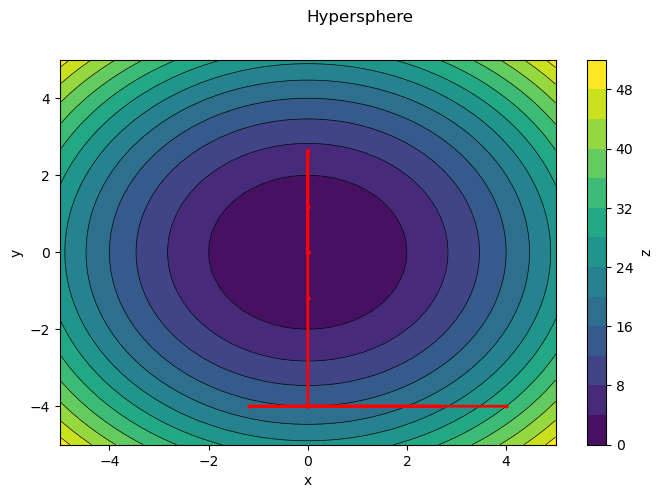

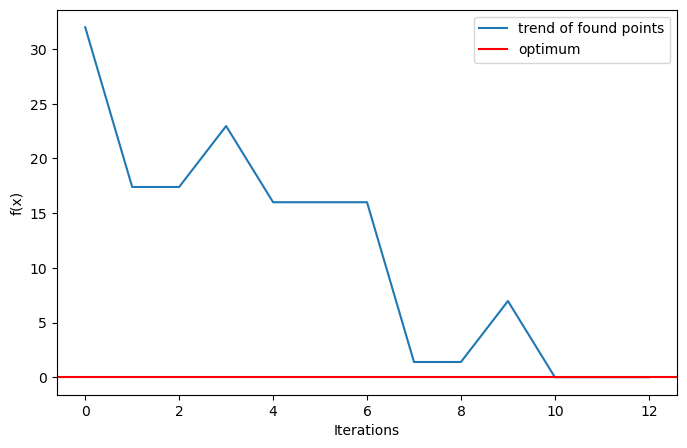

In [240]:
bench_func = bf.Hypersphere(n_dimensions=2) #TODO: try differenct benchmark functions and parameters
func = OptFun(bench_func)
print("Bounds:", func.bounds())

x_0 = [4.,-4.]  # TODO: try other suitable initial points
max_iter = 1  # TODO: try other values

result = powell(func, x_0, max_iter)
print("Best solution:", result.x)
print("Best value:", result.fun)

func.heatmap()
func.plot()

### Solution
- The parameter of the powel algorithm are starting point and maximum number of iteration, the starting point is very important because with some objective function a bad starting point could not lead to the global minimum, increasing maximum number of iteration the number of points explored is increased.

- They influence the process because they modify the constructed mutually conjugate direction and consequently all the procedure.

- The effect of these parameter are different for different function as saw in class: unless the valley is optimally oriented, this method is extremely inefficient, taking many tiny steps to get to the minimum, crossing and re-crossing the principal axis. 

- Compared to previous algorithm the powel method is different because it perform a local search by iteratively minimizing along a set of  direction and then calculate new direction.

best_results:  [10.268059142146166, 2.6797459551967955, 0.8707349746496903, 7.888609052210118e-31, 0.0, 0.0, 0.0, 0.0, 0.0]


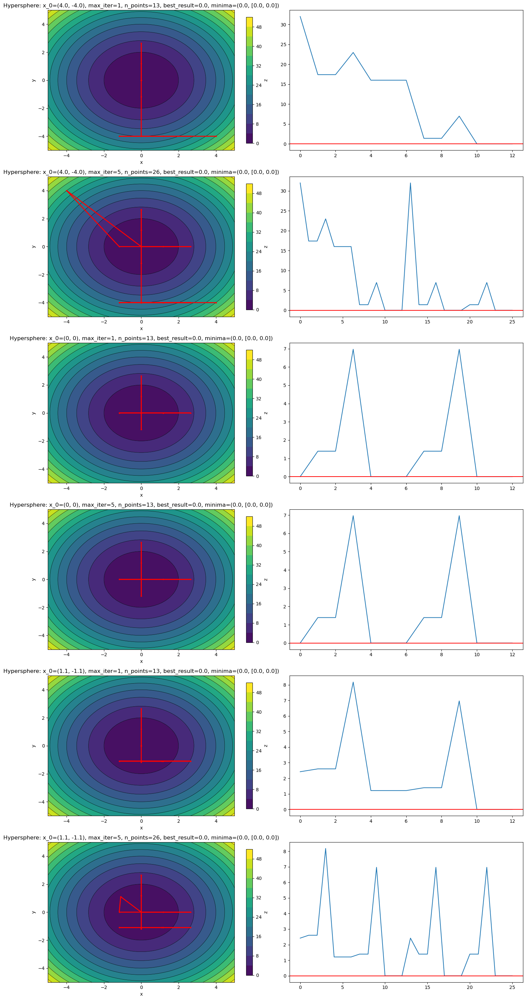

In [241]:
initial_points = [(4.,-4.), (0, 0), (1.1, -1.1)] 
max_iter_l = [1, 5]  
fig, axs = plt.subplots(len(initial_points)*len(max_iter_l), 2, figsize=(15, 30))

for i, x_0 in enumerate(initial_points):
    i = i*len(max_iter_l)
    for j, max_iter in enumerate(max_iter_l):
        bench_func = bf.Hypersphere(n_dimensions=2)
        func = OptFun(bench_func)
        result = powell(func, x_0, max_iter)
        best = result.fun
        best_results.append(best)

        n_points = len(func.history)
        axs[i+j, 0].set_title(func.f._name + ": x_0=" + str(x_0) + ", max_iter=" + str(max_iter) + 
                              ", n_points=" + str(n_points) +
                               ", best_result=" + "{:.1f}".format(best) + ", minima=" + str(func.minima()[0]))
        func.heatmap2(axs[i+j][0], fig)
        func.plot2(axs[i+j][1])

fig.tight_layout()
print("best_results: ", best_results)

### Different Functions

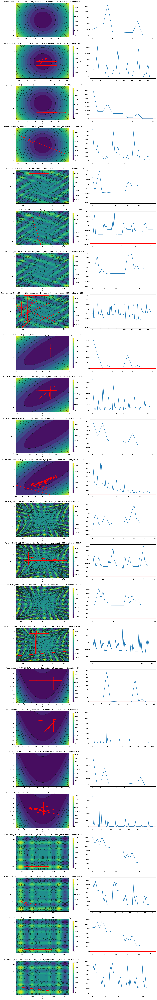

In [242]:
import random

func_list = [('Hyperellipsoid', {'n_dimensions': 2}), 
             ('EggHolder', {}),
             ('MartinGaddy', {}),
             ('Rana', {'n_dimensions': 2}),
             ('Rosenbrock', {'n_dimensions': 2}),
             ('Schwefel', {'n_dimensions': 2})
            ]
n_initial_points = 2
max_iter_l = [1, 5]
fig, axs = plt.subplots(len(func_list)*n_initial_points*len(max_iter_l), 2, figsize=(15, 100))

powel_search_results = []

for k, (func_name, params) in enumerate(func_list):
    k *= n_initial_points*len(max_iter_l)
    for i in range(n_initial_points):
        i = i*len(max_iter_l)
        bench_func = getattr(bf, func_name)(**params)
        func = OptFun(bench_func)
        bounds = func.bounds()
        x_0 = (random.uniform(bounds[0][0], bounds[0][1]), random.uniform(bounds[1][0], bounds[1][1]))
        x_0 = tuple(round(x, 2) for x in x_0)

        for j, max_iter in enumerate(max_iter_l):
            result = powell(func, x_0, max_iter)
            best = result.fun
            n_points = len(func.history)

            powel_search_results.append({  'technique' : "powel",
                                            'func_name': func_name,
                                            'x_0'      : x_0,
                                            'max_iter' : max_iter,
                                            'n_points' : n_points,
                                            'best'     : best,
                                            'minima'   : func.minima()[0].score
                                        })
        
            axs[k+i+j, 0].set_title(func.f._name + ": x_0=" + str(x_0) + ", max_iter=" + str(max_iter) + 
                               ", n_points=" + str(n_points) +
                               ", best_result=" + "{:.1f}".format(best) + 
                               ", minima=" + "{:.1f}".format(func.minima()[0].score))
            func.heatmap2(axs[k+i+j][0], fig)
            func.plot2(axs[k+i+j][1])
            
fig.tight_layout()

In [244]:
powel_search_df = pd.DataFrame(powel_search_results)
powel_search_df['err_pw'] = abs(powel_search_df['minima'] - powel_search_df['best'])
print(powel_search_df.to_markdown(index=False))

| technique   | func_name      | x_0                |   max_iter |   n_points |           best |         minima |        err_pw |
|:------------|:---------------|:-------------------|-----------:|-----------:|---------------:|---------------:|--------------:|
| powel       | Hyperellipsoid | (-11.76, -14.88)   |          1 |         13 |    3.15544e-30 |    0           |   3.15544e-30 |
| powel       | Hyperellipsoid | (-11.76, -14.88)   |          5 |         39 |    6.31089e-30 |    0           |   6.31089e-30 |
| powel       | Hyperellipsoid | (56.04, -35.28)    |          1 |         13 |    0           |    0           |   0           |
| powel       | Hyperellipsoid | (56.04, -35.28)    |          5 |         39 |    9.46633e-30 |    0           |   9.46633e-30 |
| powel       | EggHolder      | (-216.43, 393.71)  |          1 |         27 | -197.011       | -959.713       | 762.702       |
| powel       | EggHolder      | (-216.43, 393.71)  |          5 |         84 | -193.32   

### Comparison with random search

In [245]:
idx = random_search_df.groupby('func_name')['best'].idxmin()
best_random_search_df = random_search_df.loc[idx]

idx = powel_search_df.groupby('func_name')['best'].idxmin()
best_powel_search_df = powel_search_df.loc[idx]

In [246]:
merged_df = pd.merge(best_random_search_df, best_powel_search_df, on=['func_name', 'minima'], suffixes=('_rs', '_pw'))
comparison_rspw_df = merged_df[['func_name', 'minima', 'best_rs', 'best_pw', 'err_rs', 'err_pw']]
comparison_rspw_df = comparison_rspw_df.copy()
comparison_rspw_df['err_rs<err_pw'] = comparison_rspw_df['err_rs'] < comparison_rspw_df['err_pw']
print(comparison_rspw_df.to_markdown(index=False))

| func_name      |         minima |       best_rs |        best_pw |      err_rs |        err_pw | err_rs<err_pw   |
|:---------------|---------------:|--------------:|---------------:|------------:|--------------:|:----------------|
| EggHolder      | -959.713       | -882.783      | -291.585       | 76.9303     | 668.129       | True            |
| Hyperellipsoid |    0           |    0.729618   |    0           |  0.729618   |   0           | False           |
| MartinGaddy    |    0           |    0.341514   |    3.15544e-30 |  0.341514   |   3.15544e-30 | False           |
| Rana           | -511.733       | -469.482      | -252.965       | 42.2511     | 258.768       | True            |
| Rosenbrock     |    0           |    0.00926969 |    2.32171e-05 |  0.00926969 |   2.32171e-05 | False           |
| Schwefel       |    2.54557e-05 |   32.7413     |  236.877       | 32.7413     | 236.877       | True            |


Also here we can notice that sometimes random search is better and other powel is better

## Exercise 4/4: NELDER MEAD OPTIMIZATION

In this exercise we will focus on the Nelder Mead optimization algorithm.
Similar to the previous exercise, answer the following questions:

### Questions
- What happens when varying the parameters of the algorithm?
- How they influence the optimization process?
- The effects of these parameters is the same across different functions?
- How does this algorithm compare to the previous?

Bounds: [(-5.0, 5.0), (-5.0, 5.0)]
Best solution: [-1.696875  0.05    ]
Best value: 2.881884765625018


<Figure size 800x500 with 0 Axes>

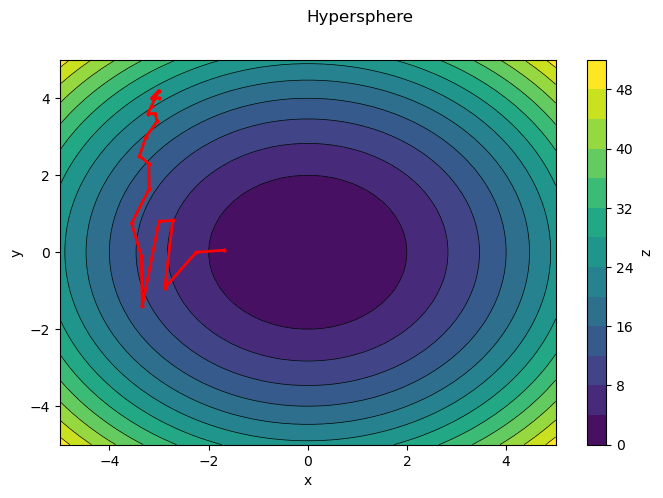

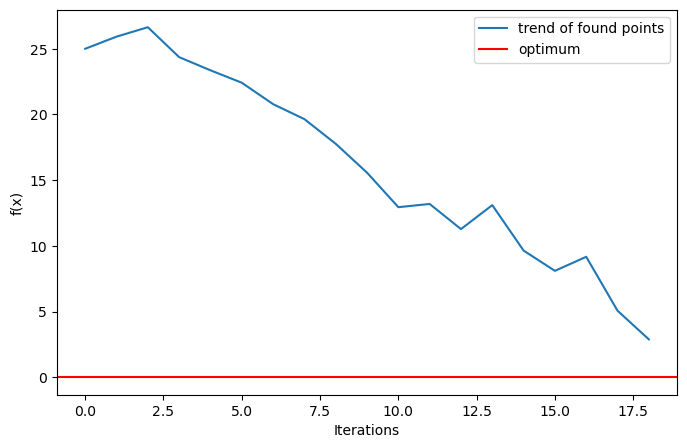

In [247]:
bench_func = bf.Hypersphere(n_dimensions=2) #TODO: try differenct benchmark functions and parameters
func = OptFun(bench_func)
print("Bounds:", func.bounds())

x_0 = [-3.,4.]  # TODO: try other suitable initial points
max_iter = 10  # TODO: try other values

result = nelder_mead(func, x_0, max_iter)
print("Best solution:", result.x)
print("Best value:", result.fun)

func.heatmap()
func.plot()

## Solutions
- The parameters are the starting point and the maximum number of iterations, with a higher number of iteration the solution is more and more refined
- The starting position influence the starting process because it is where the search start and the number of iteration specify when to stop
- The effect of the parameter is different for across different functions
- As the previous algorithm this technique doesn't require derivatives, it works locally exploring the search space with a simplex structure that is update in base of the values of the objective function trying to converge to the minimum. Nelder mead has a slower convergence but is more robust.

best_results:  [10.268059142146166, 2.6797459551967955, 0.8707349746496903, 7.888609052210118e-31, 0.0, 0.0, 0.0, 0.0, 0.0, 32.0, 1.9999999999999538, 0.003686847686765672, 0.0, 0.0, 0.0, 2.4200000000000004, 0.15124999999999747, 0.0002788178563117887]


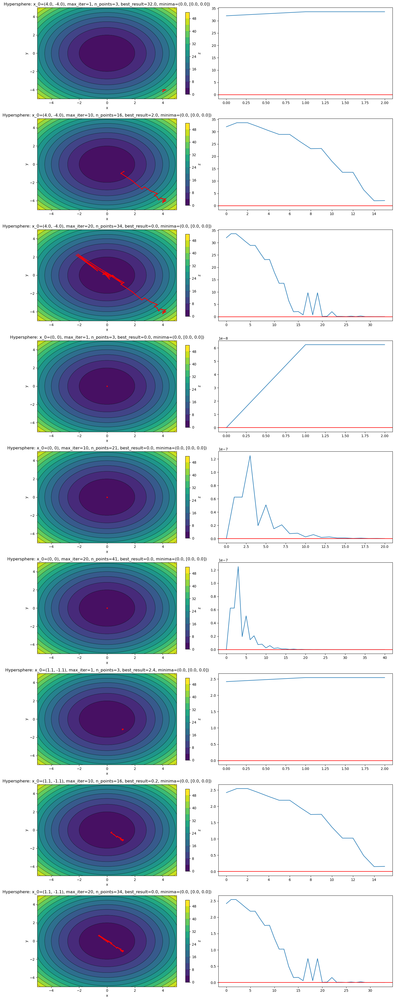

In [248]:
initial_points = [(4.,-4.), (0, 0), (1.1, -1.1)] 
max_iter_l = [1, 10, 20]  
fig, axs = plt.subplots(len(initial_points)*len(max_iter_l), 2, figsize=(15, 40))

for i, x_0 in enumerate(initial_points):
    i = i*len(max_iter_l)
    for j, max_iter in enumerate(max_iter_l):
        bench_func = bf.Hypersphere(n_dimensions=2)
        func = OptFun(bench_func)
        result = nelder_mead(func, x_0, max_iter)
        best = result.fun
        best_results.append(best)

        n_points = len(func.history)
        axs[i+j, 0].set_title(func.f._name + ": x_0=" + str(x_0) + ", max_iter=" + str(max_iter) + 
                              ", n_points=" + str(n_points) +
                               ", best_result=" + "{:.1f}".format(best) + ", minima=" + str(func.minima()[0]))
        func.heatmap2(axs[i+j][0], fig)
        func.plot2(axs[i+j][1])

fig.tight_layout()
print("best_results: ", best_results)

### Different functions

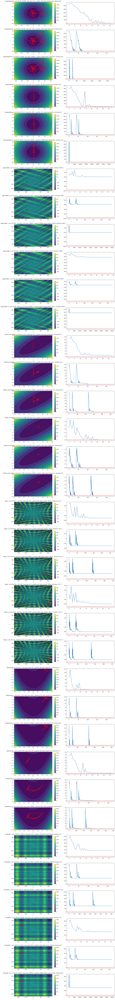

In [249]:
import random

func_list = [('Hyperellipsoid', {'n_dimensions': 2}), 
             ('EggHolder', {}),
             ('MartinGaddy', {}),
             ('Rana', {'n_dimensions': 2}),
             ('Rosenbrock', {'n_dimensions': 2}),
             ('Schwefel', {'n_dimensions': 2})
            ]
n_initial_points = 2
max_iter_l = [20, 100, 10000]
fig, axs = plt.subplots(len(func_list)*n_initial_points*len(max_iter_l), 2, figsize=(15, 140))

nelder_mead_results = []

for k, (func_name, params) in enumerate(func_list):
    k *= n_initial_points*len(max_iter_l)
    for i in range(n_initial_points):
        i = i*len(max_iter_l)
        bench_func = getattr(bf, func_name)(**params)
        func = OptFun(bench_func)
        bounds = func.bounds()
        x_0 = (random.uniform(bounds[0][0], bounds[0][1]), random.uniform(bounds[1][0], bounds[1][1]))
        x_0 = tuple(round(x, 2) for x in x_0)

        for j, max_iter in enumerate(max_iter_l):
            result = nelder_mead(func, x_0, max_iter)
            best = result.fun
            n_points = len(func.history)

            nelder_mead_results.append({  'technique' : "Nelder Mead",
                                            'func_name': func_name,
                                            'x_0'      : x_0,
                                            'max_iter' : max_iter,
                                            'n_points' : n_points,
                                            'best'     : best,
                                            'minima'   : func.minima()[0].score
                                        })
        
            axs[k+i+j, 0].set_title(func.f._name + ": x_0=" + str(x_0) + ", max_iter=" + str(max_iter) + 
                               ", n_points=" + str(n_points) +
                               ", best_result=" + "{:.1f}".format(best) + 
                               ", minima=" + "{:.1f}".format(func.minima()[0].score))
            func.heatmap2(axs[k+i+j][0], fig)
            func.plot2(axs[k+i+j][1])
            
fig.tight_layout()

In [251]:
nelder_mead_df = pd.DataFrame(nelder_mead_results)
nelder_mead_df['err_nm'] = abs(nelder_mead_df['minima'] - nelder_mead_df['best'])
print(nelder_mead_df.to_markdown(index=False))

| technique   | func_name      | x_0                |   max_iter |   n_points |           best |         minima |        err_nm |
|:------------|:---------------|:-------------------|-----------:|-----------:|---------------:|---------------:|--------------:|
| Nelder Mead | Hyperellipsoid | (33.01, 56.58)     |         20 |         38 |    1.80912     |    0           |   1.80912     |
| Nelder Mead | Hyperellipsoid | (33.01, 56.58)     |        100 |        230 |    2.94978e-22 |    0           |   2.94978e-22 |
| Nelder Mead | Hyperellipsoid | (33.01, 56.58)     |      10000 |       2809 |    0           |    0           |   0           |
| Nelder Mead | Hyperellipsoid | (2.39, 55.07)      |         20 |         39 |   11.9867      |    0           |  11.9867      |
| Nelder Mead | Hyperellipsoid | (2.39, 55.07)      |        100 |        232 |    1.22657e-21 |    0           |   1.22657e-21 |
| Nelder Mead | Hyperellipsoid | (2.39, 55.07)      |      10000 |      37686 |    0      

### Comparison with powel

In [252]:
idx = nelder_mead_df.groupby('func_name')['best'].idxmin()
best_nelder_mead_df = nelder_mead_df.loc[idx]

In [253]:
merged_df = pd.merge(best_nelder_mead_df, best_powel_search_df, on=['func_name', 'minima'], suffixes=('_nm', '_pw'))
comparison_nmpw_df = merged_df[['func_name', 'minima', 'best_nm', 'best_pw', 'err_nm', 'err_pw']]
comparison_nmpw_df = comparison_nmpw_df.copy()
comparison_nmpw_df['err_nm<err_pw'] = comparison_nmpw_df['err_nm'] < comparison_nmpw_df['err_pw']
print(comparison_nmpw_df.to_markdown(index=False))

| func_name      |         minima |   best_nm |        best_pw |   err_nm |        err_pw | err_nm<err_pw   |
|:---------------|---------------:|----------:|---------------:|---------:|--------------:|:----------------|
| EggHolder      | -959.713       |  -421.156 | -291.585       |  538.558 | 668.129       | True            |
| Hyperellipsoid |    0           |     0     |    0           |    0     |   0           | False           |
| MartinGaddy    |    0           |     0     |    3.15544e-30 |    0     |   3.15544e-30 | True            |
| Rana           | -511.733       |  -404.675 | -252.965       |  107.058 | 258.768       | True            |
| Rosenbrock     |    0           |     0     |    2.32171e-05 |    0     |   2.32171e-05 | True            |
| Schwefel       |    2.54557e-05 |   335.578 |  236.877       |  335.578 | 236.877       | False           |


## Final questions
- How the benchmark functions influence the optimization algorithms? There is an algorithm which is always better than the other?
- The choiche of the parameters is influenced by the function to optimize? And how the algorithm are influenced by the parameters?

- Looking at the comparison tables there is never the case that an algorithm is always better than another in our experiments, this is expected by the no free lunch theorem: no algorithm can outperform all others across all possible problems
- Yes, the choice of parameters is influenced by the function to optimize. For the grid search we have the subset of search space and step size of the grid that is influenced by how smooth the function is. For the random search also if the function is very irregular we need more points to understand how the function behave, but generally for grid search and random search the more points we evaluate the better. For powel and nelder mead is very important the starting point and in particular for nelder mead which has a slower convergence the number of max_iteration is also important
The grid search and random search are influenced by the parameters which determine the exploration and exploitation of the search space, for powel and nelder mead the starting point can lead only to a local minimum and the number of max_iteration influence the refinement of the search.